In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim 
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

In [2]:
import torchvision.models

alexnet = torchvision.models.alexnet(pretrained=True)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 172MB/s]


In [3]:
from google.colab import drive
drive.mount('/content/drive')

import zipfile
import os

#zip_ref = zipfile.ZipFile('/content/drive/MyDrive/APS360 Project Team/Data/Blood_Cell_Dataset_Small_Split.zip', 'r') #Opens the zip file in read mode
zip_ref = zipfile.ZipFile('/content/drive/MyDrive/APS360 Project Team/Data/Blood_Cell_Dataset_Small_Split.zip', 'r') #fiona's path
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

Mounted at /content/drive


In [ ]:
torch.manual_seed(1)

#only want the filter weights, not the classifier
convalexnet = alexnet.features

convalexnet

In [24]:
transform = transforms.Compose([ #resize all images to height and width of 280
         transforms.ToTensor()        #transform images to tensors
         ])

classes = ['basophil', 'eosinophil', 'erythroblast', 'ig', 'lymphocyte', 'monocyte', 
               'neutrophil', 'platelet']

In [6]:
class proposed2(nn.Module):
    def __init__(self, input_size, hidden_size, num_class):
        super(proposed2, self).__init__()
        #self.fc = nn.Linear(10*256*7*7 + hidden_size*3, num_class) #temp sizes, idk what the dimensions should be
        #256*7*7 for alexnet, 512*8*8 for vgg16
        self.name = "Proposed2"
        #also how many classes are there?
        self.rnn = nn.RNN(input_size, hidden_size, batch_first=True)
        self.hidden_size = hidden_size
        self.fcCNN = nn.Linear(256*7*7, 60) #64*34*34 #192*16*16 #192*34*34
        self.fcRNN = nn.Linear(hidden_size, 60)
        self.fc = nn.Linear(60+60, num_class)
    def forward(self, x):
        
        cnnpath = convalexnet(x) #convgg16(x)
        #cnnpath = torch.flatten(cnnpath, 1) #x = x.view(-1, 512*8*8) #maybe this one? but idk dimensions
        
        x = torch.flatten(x, 2,3) #x.view(-1, 78400) #2352000?
        x = x.permute(1, 0, 2) 
        h0 = torch.zeros(1, len(x), self.hidden_size)
        #if use_cuda:
        h0=h0.to(device)
        
        rnnpath, __=self.rnn(x, h0)

        rnnpath = rnnpath[-1,:,:]
        
        cnnpath = torch.flatten(cnnpath, 1)
        cnnpath = F.relu(self.fcCNN(cnnpath))
        rnnpath = F.relu(self.fcRNN(rnnpath))
        
        merged = torch.cat((cnnpath, rnnpath),1)
        #print(merged.shape)
        x = self.fc(merged)

        return x

# Class Testing

In [29]:
def get_accuracy_class(model, data):
    correct = 0
    total = 0

    for imgs, labels in torch.utils.data.DataLoader(data, batch_size=25):
        #############################################
        #To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
          
        #############################################
        #print("here",imgs.shape)
        output = model(imgs)
        
        #select index with maximum prediction score
        pred = output.max(1, keepdim=True)[1] #idk if model will give probability of the classes or what
        correct += pred.eq(labels.view_as(pred)).sum().item() #do we need to apply soft max??
        total += imgs.shape[0]
    return correct / total

In [30]:
# run the get_accuray for the best model for every class to see which performs better
from torch.utils.data import DataLoader, Subset

test_data = torchvision.datasets.ImageFolder("/tmp/content/Blood_Cell_Dataset_Small_Split/test", transform=transform)

basophil_dset = Subset(test_data, range(0, 25))
eosinophil_dset = Subset(test_data, range(25, 50))
erythroblast_dset = Subset(test_data, range(50, 75))
ig_dset = Subset(test_data, range(75, 100))
lymphocyte_dset = Subset(test_data, range(100, 125))
monocyte_dset = Subset(test_data, range(125, 150))
neutrophil_dset = Subset(test_data, range(150, 175))
platelet_dset = Subset(test_data, range(175, 200))

In [31]:
# load in the model

hidden_size = 64 #this needs to be the hidden size of the model you chose
qual_net = proposed2(78400, hidden_size, 8)
model_path = "/content/drive/MyDrive/APS360 Project Team/Saved Models/model_h64_bs64_lr0.005_epoch7" # the path of the model you chose
state = torch.load(model_path)
qual_net.load_state_dict(state)

<All keys matched successfully>

In [32]:
# seperate classes testing

use_cuda = True
device = "cuda"
qual_net.to(device)
convalexnet.to(device)

basophil_acc = get_accuracy_class(qual_net, basophil_dset)
eosinophil_acc = get_accuracy_class(qual_net, eosinophil_dset)
erythroblast_acc = get_accuracy_class(qual_net, erythroblast_dset)
ig_acc = get_accuracy_class(qual_net, ig_dset)
lymphocyte_acc = get_accuracy_class(qual_net, lymphocyte_dset)
monocyte_acc = get_accuracy_class(qual_net, monocyte_dset)
neutrophil_acc = get_accuracy_class(qual_net, neutrophil_dset)
platelet_acc = get_accuracy_class(qual_net, platelet_dset)

print("Basophil Test Accuracy: {}".format(basophil_acc))
print("Eosinophil Test Accuracy: {}".format(eosinophil_acc))
print("Erythroblast Test Accuracy: {}".format(erythroblast_acc))
print("IG Test Accuracy: {}".format(ig_acc))
print("Lymphocyte Test Accuracy: {}".format(lymphocyte_acc))
print("Monocyte Test Accuracy: {}".format(monocyte_acc))
print("Neutrophil Test Accuracy: {}".format(neutrophil_acc))
print("Platelet Test Accuracy: {}".format(platelet_acc))

Basophil Test Accuracy: 1.0
Eosinophil Test Accuracy: 0.92
Erythroblast Test Accuracy: 0.92
IG Test Accuracy: 0.68
Lymphocyte Test Accuracy: 1.0
Monocyte Test Accuracy: 0.92
Neutrophil Test Accuracy: 0.96
Platelet Test Accuracy: 1.0


In [54]:
def qual_outputs(loader):
  n = 0
  for image, label in loader:

    if use_cuda and torch.cuda.is_available():
                image = image.cuda()
                label = label.cuda()

    single_output = qual_net(image)     #generate an array of probabilities for each class
    pred = single_output.max(1, keepdim=True)[1]  #determine the class that is predicted

    plt.subplot(5, 5, n+1)
    img = image.cpu()[0]
    imgx = np.transpose(img, [1,2,0])
    imgx = imgx / 2 + 0.5   #normalize values
    plt.rcParams['figure.figsize'] = [20, 20]    #resize
    plt.imshow(imgx)
    plt.axis('off')
    plt.title('Label:' + classes[label[0]] + '\nPrediction:' + classes[pred[0]])

    n = n + 1

    if n > 24:
      break

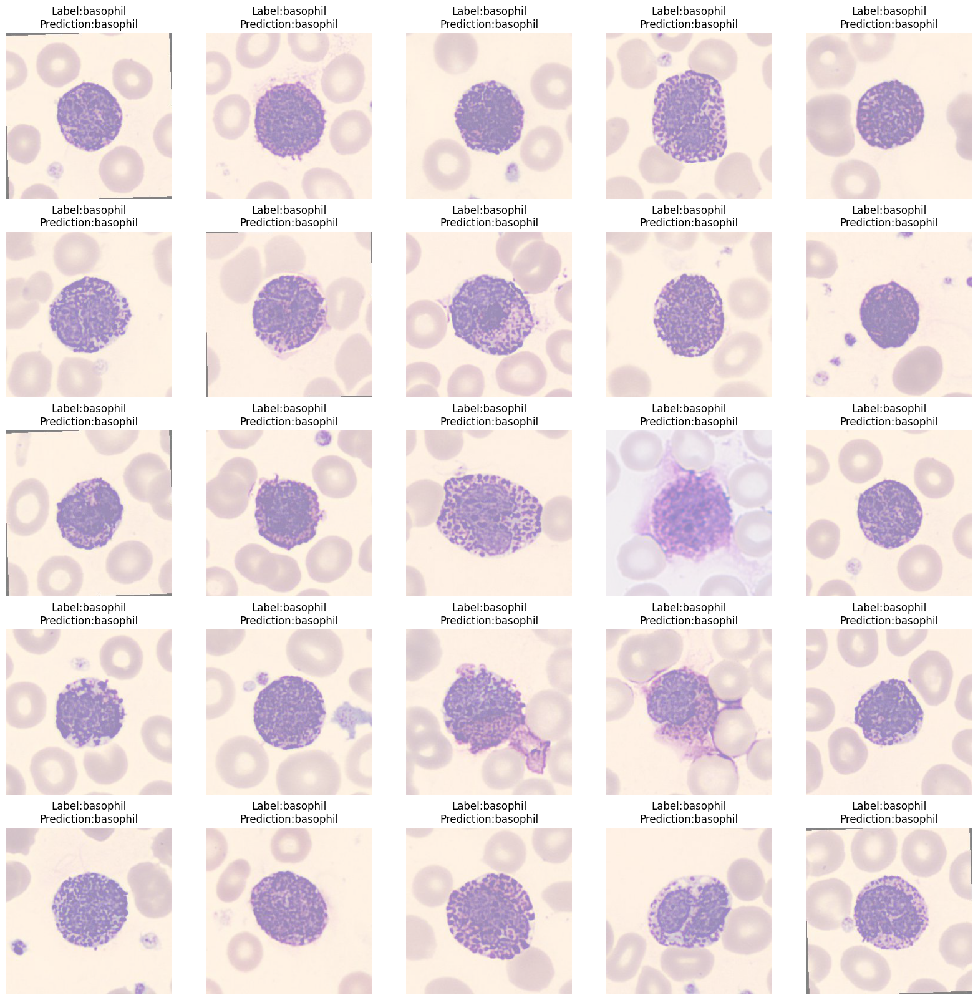

In [58]:
import numpy as np

basophil_loader = torch.utils.data.DataLoader(basophil_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(basophil_loader)

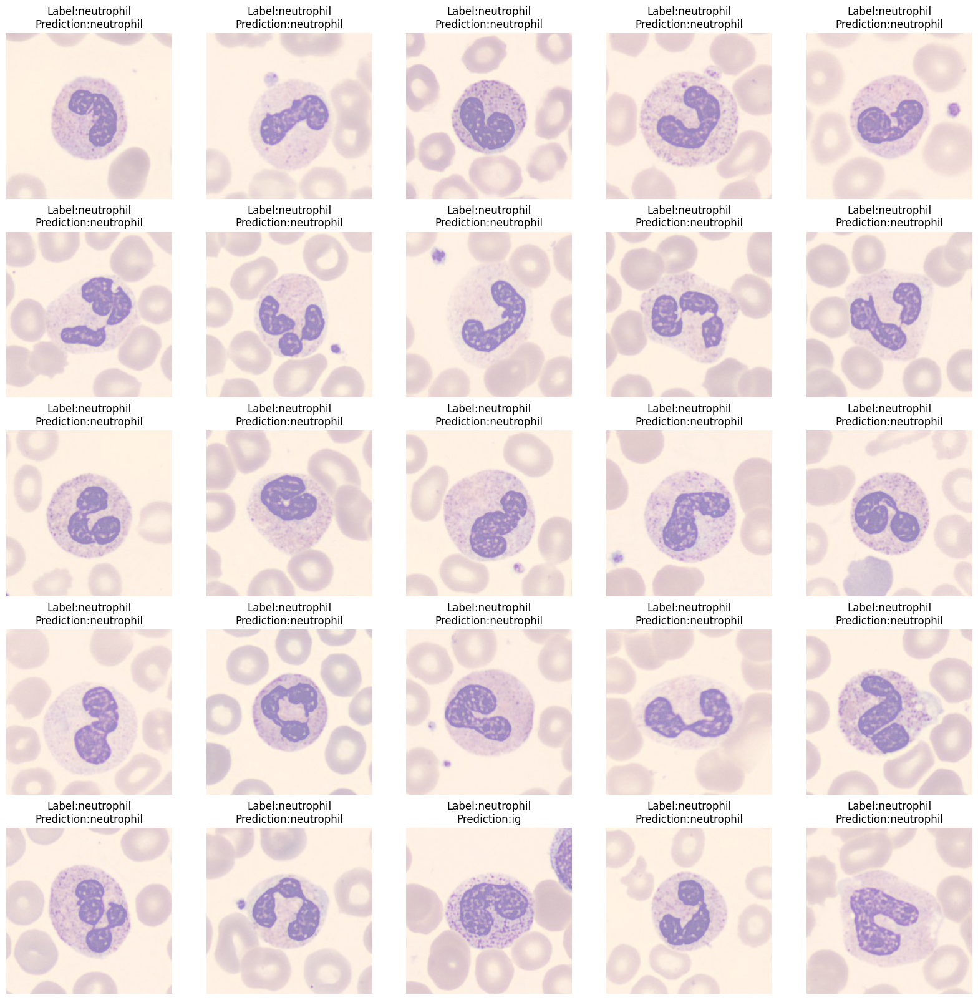

In [59]:
neutrophil_loader = torch.utils.data.DataLoader(neutrophil_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(neutrophil_loader)

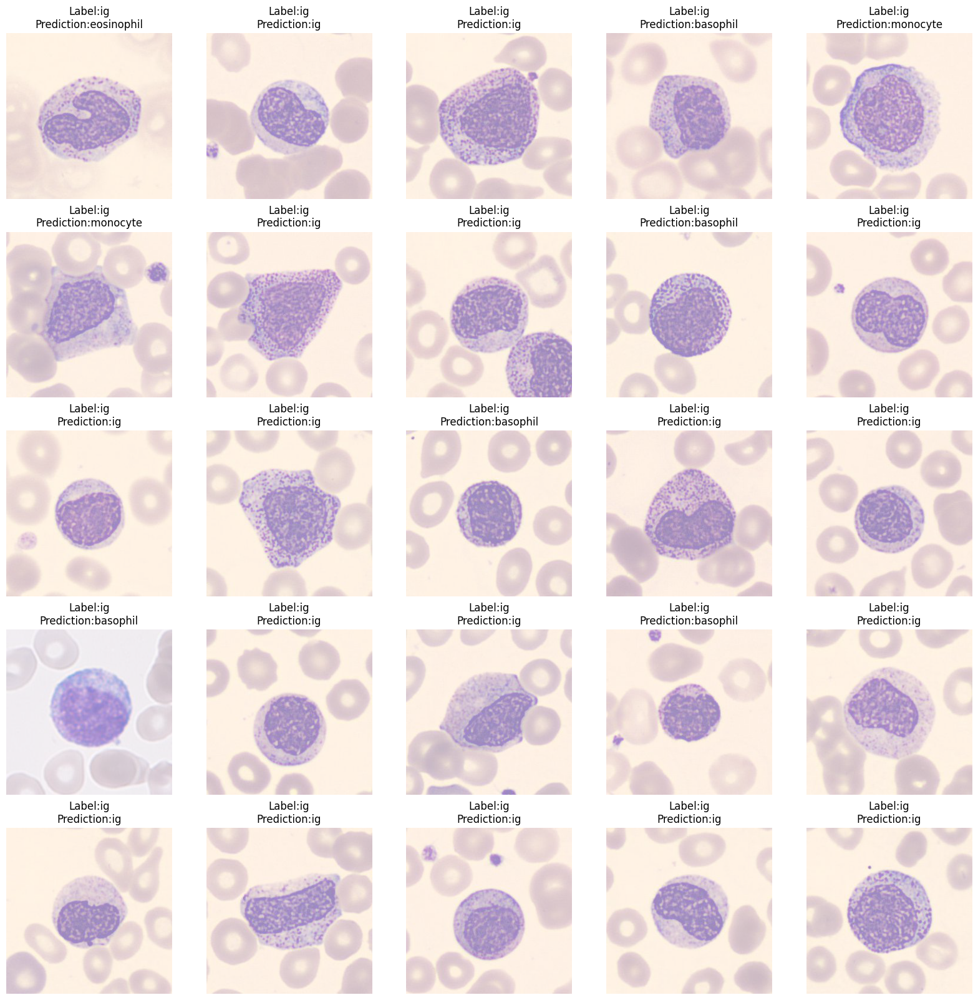

In [60]:
ig_loader = torch.utils.data.DataLoader(ig_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(ig_loader)

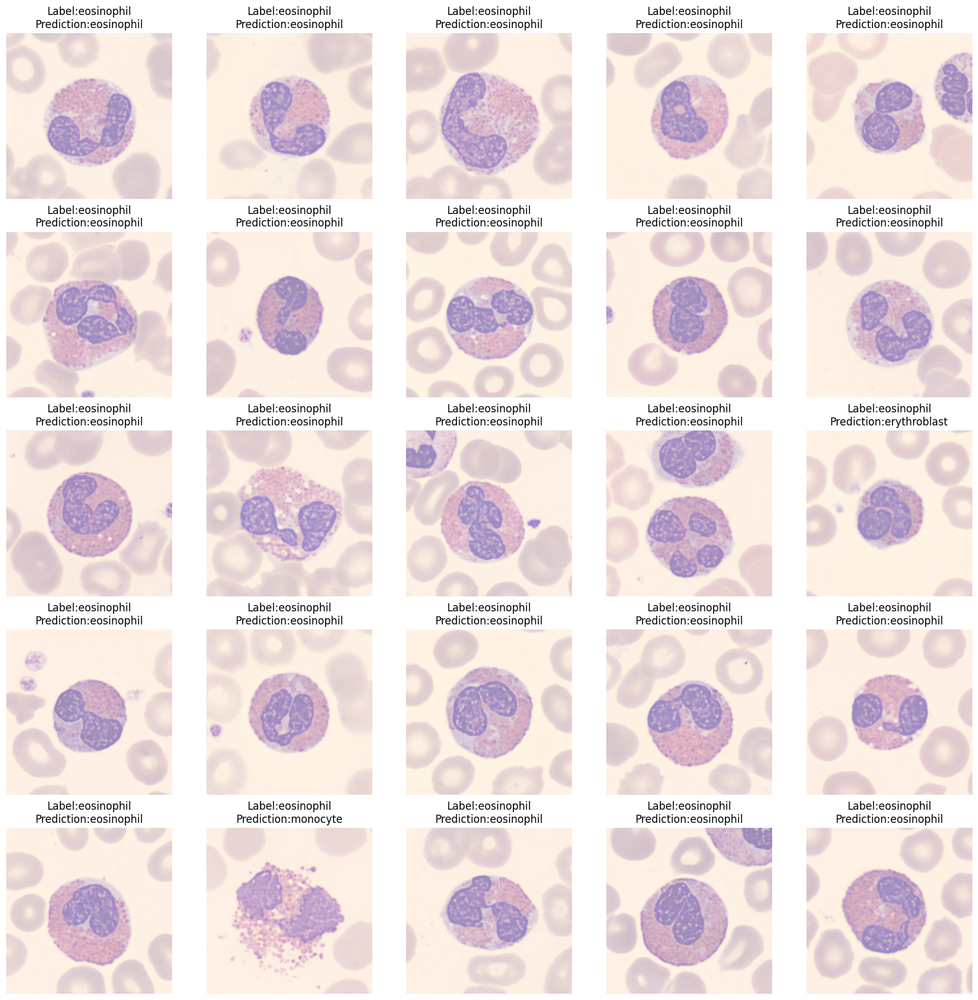

In [61]:
eosinophil_loader = torch.utils.data.DataLoader(eosinophil_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(eosinophil_loader)

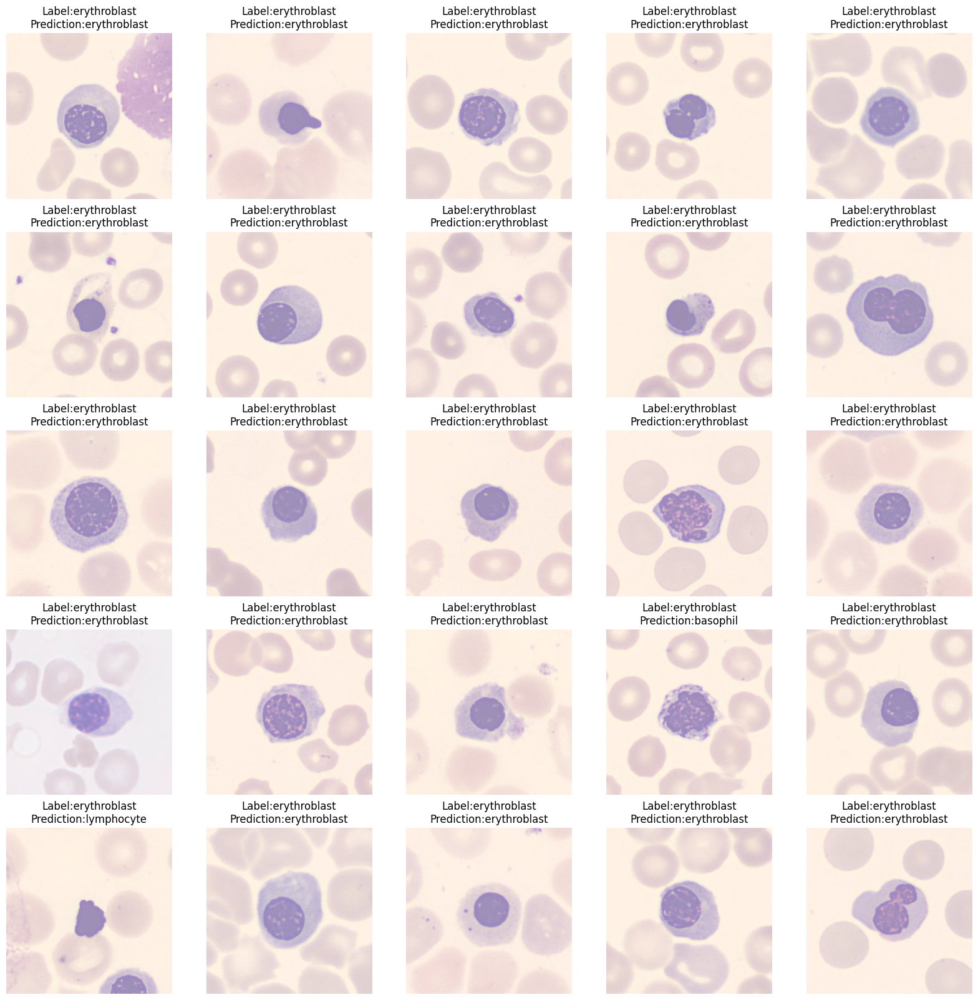

In [62]:
erythroblast_loader = torch.utils.data.DataLoader(erythroblast_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(erythroblast_loader)

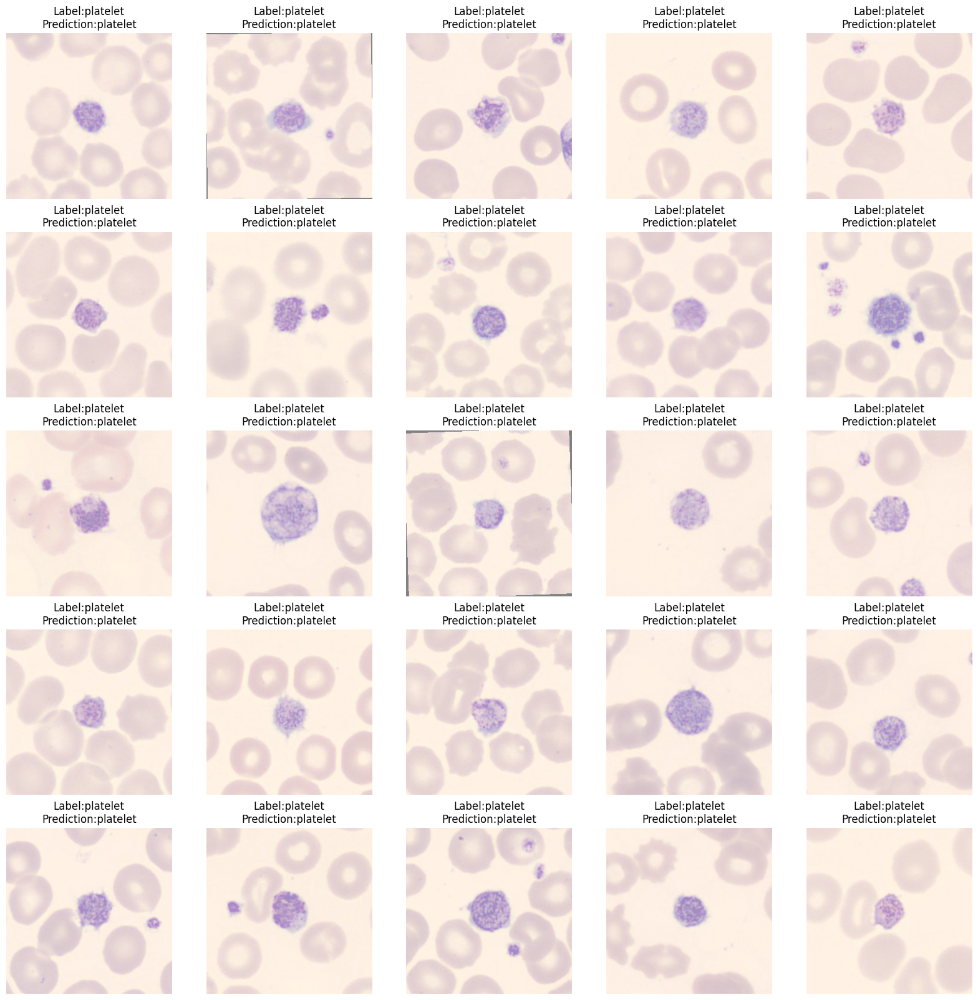

In [63]:
platelet_loader = torch.utils.data.DataLoader(platelet_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(platelet_loader)

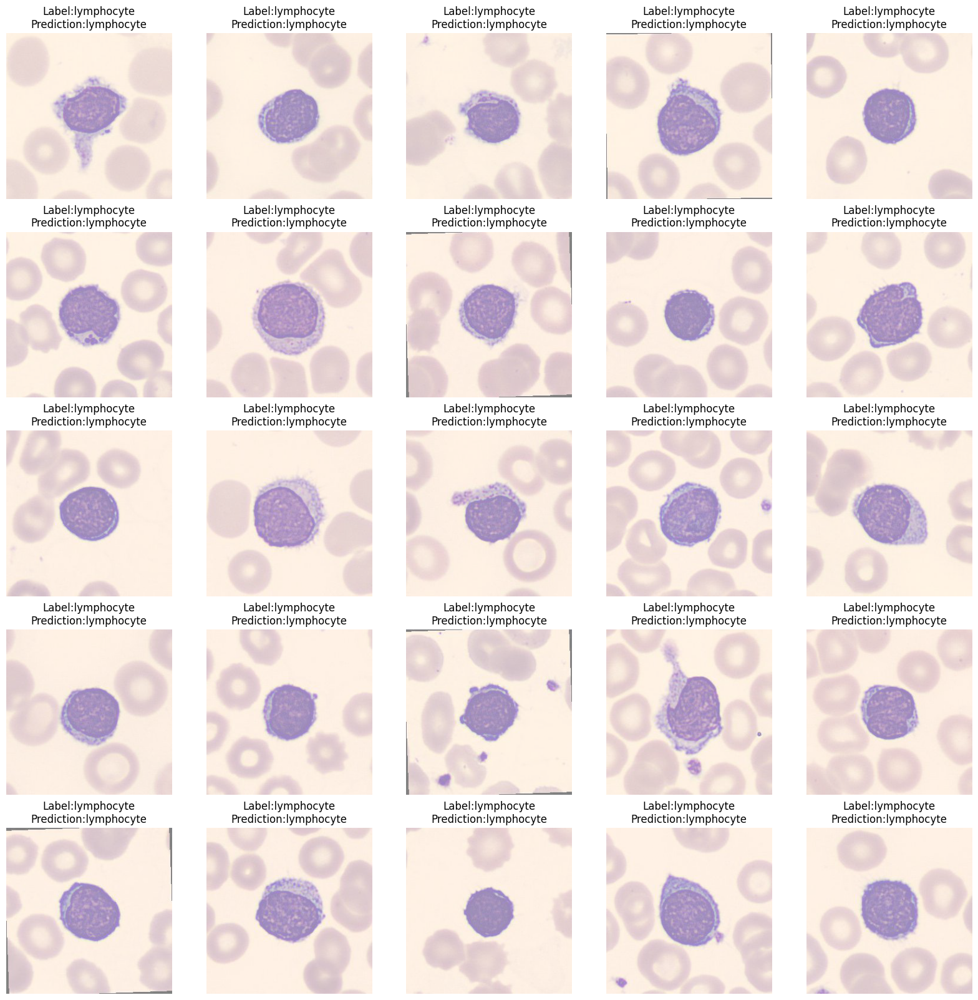

In [64]:
lymphocyte_loader = torch.utils.data.DataLoader(lymphocyte_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(lymphocyte_loader)

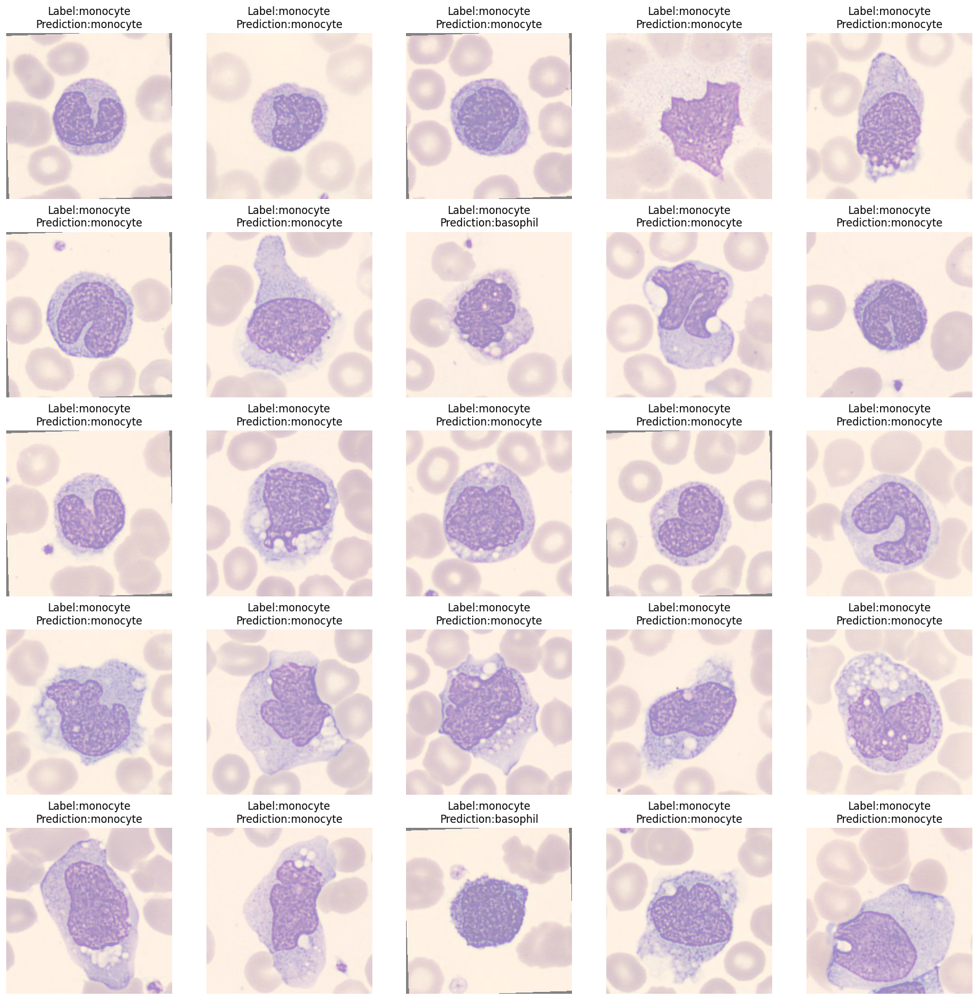

In [65]:
monocyte_loader = torch.utils.data.DataLoader(monocyte_dset, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(monocyte_loader)

# Resolution 

In [41]:
def get_accuracy_dataset(model, data):
    correct = 0
    total = 0

    for imgs, labels in torch.utils.data.DataLoader(data, batch_size=64):

        #############################################
        #To Enable GPU Usage
        if use_cuda and torch.cuda.is_available():
          imgs = imgs.cuda()
          labels = labels.cuda()
          
        #############################################
        #print("here",imgs.shape)
        output = model(imgs)
        
        #select index with maximum prediction score
        pred = output.max(1, keepdim=True)[1] #idk if model will give probability of the classes or what
        #print(pred)
        correct += pred.eq(labels.view_as(pred)).sum().item() #do we need to apply soft max??
        total += imgs.shape[0]
    return correct / total

In [42]:
# separate dataset testing

zip_ref = zipfile.ZipFile('/content/drive/MyDrive/APS360 Project Team/Data/Blood_Cell_Dataset_Split.zip', 'r') 
zip_ref.extractall('/tmp') #Extracts the files into the /tmp folder
zip_ref.close()

In [43]:
# we only took lymphocyte and monocyte from the smaller dataset, so compare test accuracy on those
# taking from the huge dataset, so never before seen data
qual_data = torchvision.datasets.ImageFolder("/tmp/content/Blood_Cell_Dataset_Split/train", transform=transform)
len(qual_data)

19200

In [44]:
# 2400 images per class in test folder
# 0-2400, 2400-4800, 4800-7200, 7200-9600, lymphocyte = 9600-12000 (31), monocyte = 12000-14400 (18)
# second -> smaller dataset that was combined
# lymphocyte_second is first 18 images in that subset -> 9600-9618
lymphocyte_second = Subset(qual_data, range(9600, 9618))

# monocyte_second is first two images in that subset -> 12000-12018
monocyte_second = Subset(qual_data, range(12000, 12018))

In [45]:
lymphocyte_second_acc = get_accuracy_dataset(qual_net, lymphocyte_second)

monocyte_second_acc = get_accuracy_dataset(qual_net, monocyte_second)

print("Lymphocyte Accuracy from Smaller (the one we added) Dataset: {}".format(lymphocyte_second_acc))
print("Monocyte Accuracy from Smaller Dataset (the one we added): {}".format(monocyte_second_acc))

Lymphocyte Accuracy from Smaller (the one we added) Dataset: 1.0
Monocyte Accuracy from Smaller Dataset (the one we added): 0.4444444444444444


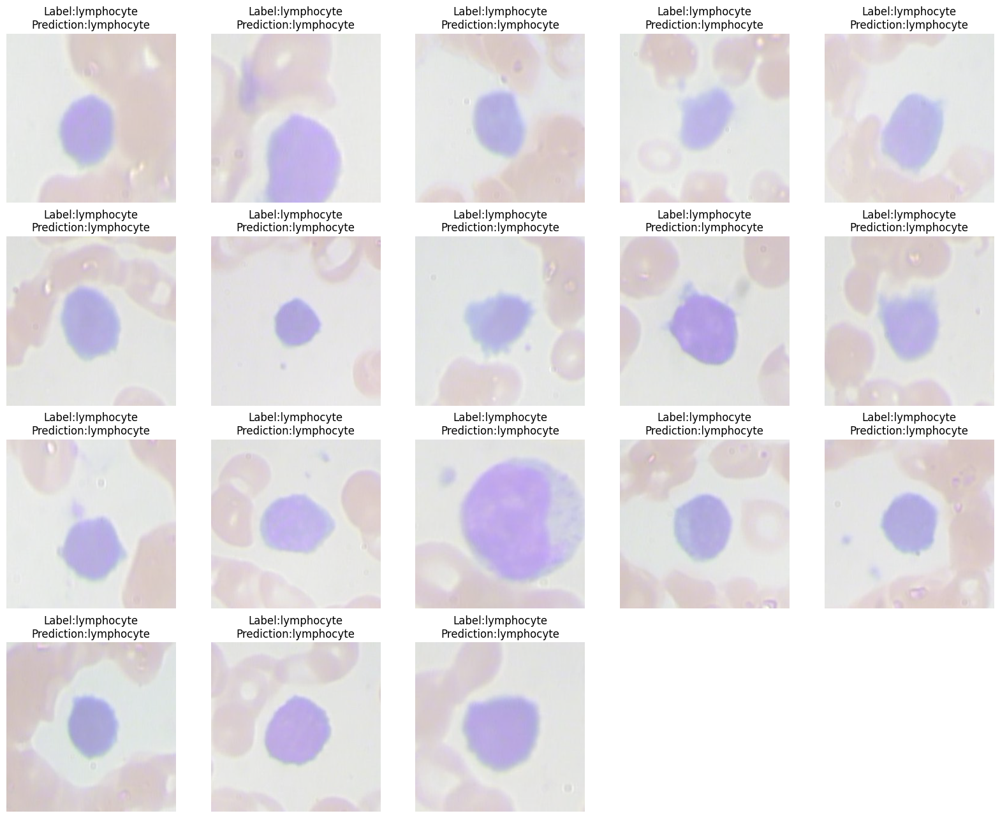

In [56]:
lymphocyte_sec_loader = torch.utils.data.DataLoader(lymphocyte_second, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(lymphocyte_sec_loader)

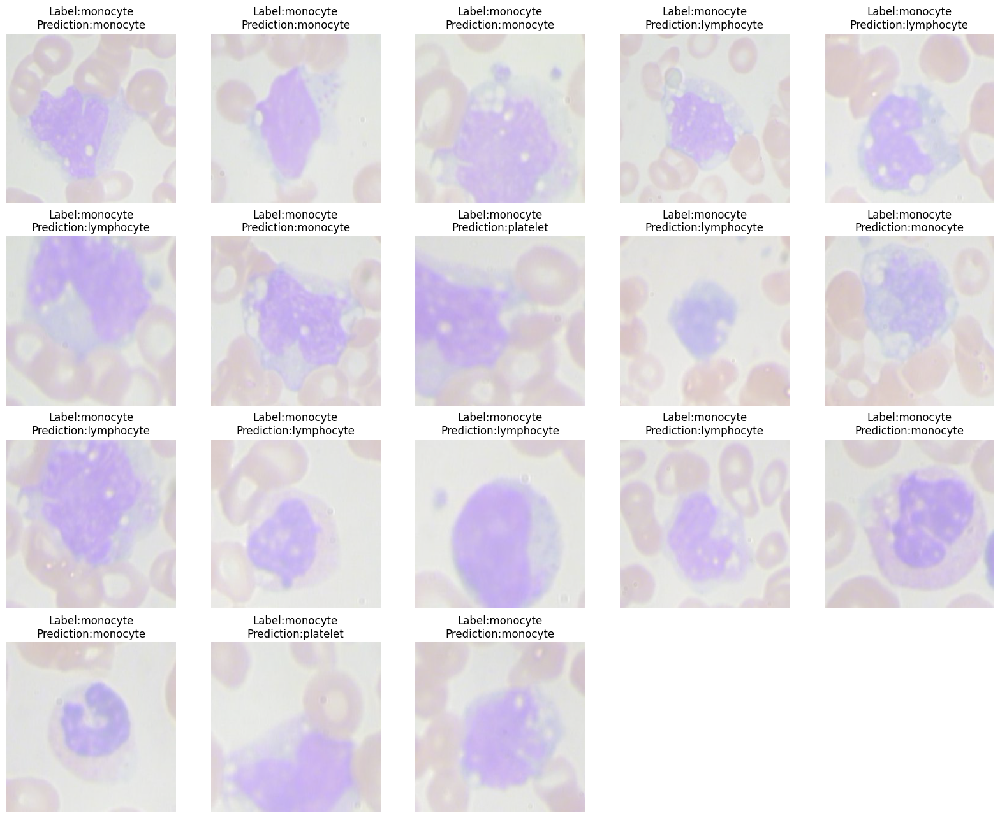

In [57]:
monocyte_sec_loader = torch.utils.data.DataLoader(monocyte_second, batch_size=1, num_workers=1, shuffle=True)
qual_outputs(monocyte_sec_loader)